<a href="https://colab.research.google.com/github/akankshsathish/EDA-and-ML-projects/blob/main/Black_Friday_Sales_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![](https://images.thequint.com/thequint%2F2022-11%2Fa2ed7a4c-d911-4c0a-9541-3c25db234c27%2Fblack_friday_banner_or_poster_design_jpg_s_1024x1024_w_is_k_20_c_fRzBt9HlN_t4JWtedgGn1NBlaqnd5ETT4XA.jpg?auto=format%2Ccompress&fmt=webp&width=720)











---


Black Friday is an informal name for the Friday following Thanksgiving Day in
the United States, which is celebrated on the fourth Thursday of November.

A retail company wants to understand customer purchase behaviour (specifically, purchase amount) against various products of different categories. They have shared a purchase summary of various customers for selected high volume products from last month.


---



# **Description of the data**

The important features in the dataset are

(1) Gender → Categorical column with values (M/F)

(2) Age → Categorical column with values ranging from 0 to 55 and above

(3) Occupations → Categorical field with 20 different types of occupation

(4) Cities → Categorical field with 3 different cities [A city, B city, C city]

(5) Residing years → Categorical column ranging from values [0,1,2,3,4+]

(6) Marital Status → Categorical field with values (1/0) representing Married/Unmarried respectively.

(7) Product Category 1 → Numerical value indicating quantity purchased

(8) Product Category 2 → Numerical value indicating quantity purchased

(9) Product Category 3 → Numerical value indicating quantity purchased

(10) Purchase → Numerical value indicating total purchased product in price

In [ ]:
# to perform mathematical functions and data manipulation
import numpy as np
import pandas as pd

# visualisation tools
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# to ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_csv('/content/train.csv')
df

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,NaN,NaN,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.0,14.0,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,NaN,NaN,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,14.0,NaN,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,NaN,NaN,7969
...,...,...,...,...,...,...,...,...,...,...,...,...
550063,1006033,P00372445,M,51-55,13,B,1,1,20,NaN,NaN,368
550064,1006035,P00375436,F,26-35,1,C,3,0,20,NaN,NaN,371
550065,1006036,P00375436,F,26-35,15,B,4+,1,20,NaN,NaN,137
550066,1006038,P00375436,F,55+,1,C,2,0,20,NaN,NaN,365


## **Let us perform few basic descriptive statistics to analyse the dataset**

In [ ]:
print('Shape of dataframe: {}'.format(df.shape))

Shape of dataframe: (550068, 12)


In [ ]:
# to display columns of 'Object' datatype
for i in df.columns:
  if df[i].dtype == 'object':
    print('Column Name: {}'.format(i))
    print(df[i].value_counts())
    print('*'*50,'\n\n')

Column Name: Product_ID
P00265242    1880
P00025442    1615
P00110742    1612
P00112142    1562
P00057642    1470
             ... 
P00314842       1
P00298842       1
P00231642       1
P00204442       1
P00066342       1
Name: Product_ID, Length: 3631, dtype: int64
************************************************** 


Column Name: Gender
M    414259
F    135809
Name: Gender, dtype: int64
************************************************** 


Column Name: Age
26-35    219587
36-45    110013
18-25     99660
46-50     45701
51-55     38501
55+       21504
0-17      15102
Name: Age, dtype: int64
************************************************** 


Column Name: City_Category
B    231173
C    171175
A    147720
Name: City_Category, dtype: int64
************************************************** 


Column Name: Stay_In_Current_City_Years
1     193821
2     101838
3      95285
4+     84726
0      74398
Name: Stay_In_Current_City_Years, dtype: int64
********************************************

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 550068 entries, 0 to 550067
Data columns (total 12 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   User_ID                     550068 non-null  int64  
 1   Product_ID                  550068 non-null  object 
 2   Gender                      550068 non-null  object 
 3   Age                         550068 non-null  object 
 4   Occupation                  550068 non-null  int64  
 5   City_Category               550068 non-null  object 
 6   Stay_In_Current_City_Years  550068 non-null  object 
 7   Marital_Status              550068 non-null  int64  
 8   Product_Category_1          550068 non-null  int64  
 9   Product_Category_2          376430 non-null  float64
 10  Product_Category_3          166821 non-null  float64
 11  Purchase                    550068 non-null  int64  
dtypes: float64(2), int64(5), object(5)
memory usage: 50.4+ MB


In [ ]:
df.describe()

,User_ID,Occupation,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
count,5.500680e+05,550068.000000,550068.000000,550068.000000,376430.000000,166821.000000,550068.000000
mean,1.003029e+06,8.076707,0.409653,5.404270,9.842329,12.668243,9263.968713
std,1.727592e+03,6.522660,0.491770,3.936211,5.086590,4.125338,5023.065394
min,1.000001e+06,0.000000,0.000000,1.000000,2.000000,3.000000,12.000000
25%,1.001516e+06,2.000000,0.000000,1.000000,5.000000,9.000000,5823.000000
50%,1.003077e+06,7.000000,0.000000,5.000000,9.000000,14.000000,8047.000000
75%,1.004478e+06,14.000000,1.000000,8.000000,15.000000,16.000000,12054.000000
max,1.006040e+06,20.000000,1.000000,20.000000,18.000000,18.000000,23961.000000


##**Check for missing values in the data**

In [ ]:
# percentage of null values in each column
(df.isnull().sum() / df.shape[0]) * 100

User_ID                        0.000000
Product_ID                     0.000000
Gender                         0.000000
Age                            0.000000
Occupation                     0.000000
City_Category                  0.000000
Stay_In_Current_City_Years     0.000000
Marital_Status                 0.000000
Product_Category_1             0.000000
Product_Category_2            31.566643
Product_Category_3            69.672659
Purchase                       0.000000
dtype: float64

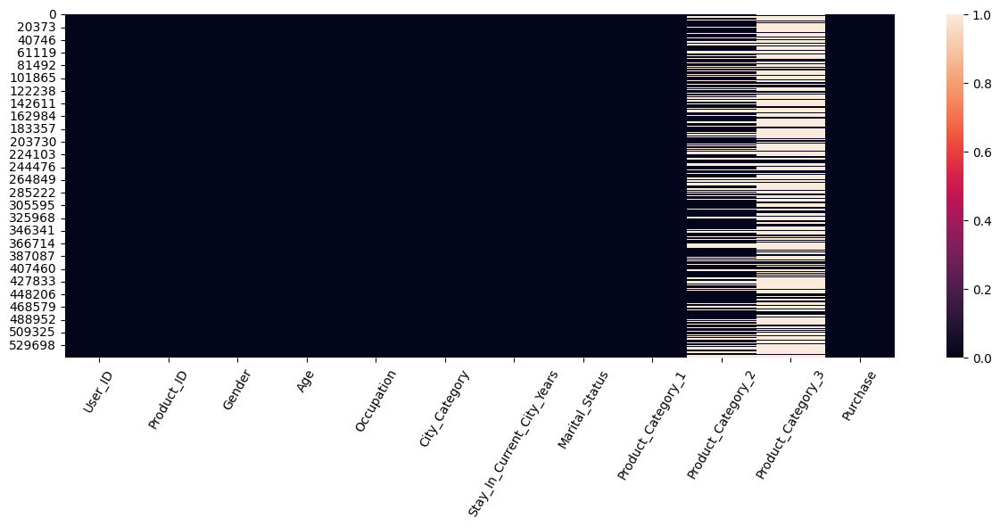

In [ ]:
plt.figure(figsize=(15,5))
g = sns.heatmap(df.isnull())
g.set_xticklabels(df.columns, rotation=60);

    In this case, heatmap is used to visualize the patterns of missing value occurrence with python

In [ ]:
# renaming columns to keep it precise and short
df.rename(columns={'User_ID':'UserID','Product_ID':'ProductID','Product_Category_1':'Product1',
                   'Product_Category_2':'Product2','Product_Category_3':'Product3',
                   'Stay_In_Current_City_Years':'Yrs_in_City'}, inplace=True)
df

,UserID,ProductID,Gender,Age,Occupation,City_Category,Yrs_in_City,Marital_Status,Product1,Product2,Product3,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,NaN,NaN,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.0,14.0,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,NaN,NaN,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,14.0,NaN,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,NaN,NaN,7969
...,...,...,...,...,...,...,...,...,...,...,...,...
550063,1006033,P00372445,M,51-55,13,B,1,1,20,NaN,NaN,368
550064,1006035,P00375436,F,26-35,1,C,3,0,20,NaN,NaN,371
550065,1006036,P00375436,F,26-35,15,B,4+,1,20,NaN,NaN,137
550066,1006038,P00375436,F,55+,1,C,2,0,20,NaN,NaN,365


##**Convert categorical data into integer using map function**

In [ ]:
df['Gender'] = df['Gender'].map({'F':0, 'M':1}).astype(int)
df

,UserID,ProductID,Gender,Age,Occupation,City_Category,Yrs_in_City,Marital_Status,Product1,Product2,Product3,Purchase
0,1000001,P00069042,0,0-17,10,A,2,0,3,NaN,NaN,8370
1,1000001,P00248942,0,0-17,10,A,2,0,1,6.0,14.0,15200
2,1000001,P00087842,0,0-17,10,A,2,0,12,NaN,NaN,1422
3,1000001,P00085442,0,0-17,10,A,2,0,12,14.0,NaN,1057
4,1000002,P00285442,1,55+,16,C,4+,0,8,NaN,NaN,7969
...,...,...,...,...,...,...,...,...,...,...,...,...
550063,1006033,P00372445,1,51-55,13,B,1,1,20,NaN,NaN,368
550064,1006035,P00375436,0,26-35,1,C,3,0,20,NaN,NaN,371
550065,1006036,P00375436,0,26-35,15,B,4+,1,20,NaN,NaN,137
550066,1006038,P00375436,0,55+,1,C,2,0,20,NaN,NaN,365


In [ ]:
df.Age.unique()

array(['0-17', '55+', '26-35', '46-50', '51-55', '36-45', '18-25'],
      dtype=object)

In [ ]:
df['Age'] = df['Age'].replace(['0-17', '18-25', '26-35', '36-45', '46-50', '51-55', '55+'],
                              ['child', 'teenage', 'adult', 'adult', 'mid-age', 'mid-age', 'old'])

In [ ]:
df.Age

0           child
1           child
2           child
3           child
4             old
           ...   
550063    mid-age
550064      adult
550065      adult
550066        old
550067    mid-age
Name: Age, Length: 550068, dtype: object

In [ ]:
df.Age = df.Age.map({'child':0,'teenage':1,'adult':2,'mid-age':3,'old':4}).astype(int)

In [ ]:
df.Age

0         0
1         0
2         0
3         0
4         4
         ..
550063    3
550064    2
550065    2
550066    4
550067    3
Name: Age, Length: 550068, dtype: int64

## **Filling Nan values in Product2 column**

    Since only 1/3rd of the Product2 column values are missing/null, filling them up with the mean value of the column is the most preferred option.

In [ ]:
prod2_mean = df['Product2'].mean().round()
prod2_mean

10.0

In [ ]:
df['Product2'] = df['Product2'].fillna(prod2_mean)

## **Filling Nan values in Product3 column**

    In product3 column, alomst 70% of the values are missing. Hence, we could either drop the entire column or
    replace the null values with the median of the column.
    To perform better analysis, going with the second option seemed to be more relevant since median is considered to be the most
    informative measure of central tendency for skewed distributions.

In [ ]:
prod3_med = df['Product3'].median()
prod3_med

14.0

In [ ]:
df['Product3'] = df['Product3'].fillna(prod3_med)

# **Univariate Analysis**

Q: 1) Which age group visits the store frequently? Show the distribution of other age groups as well?

Q: 2) Which gender group visits the store most often on a Black Friday Sale?

Q: 3) Find customers belonging to what occupation tend to show up at the store.

Q: 4) Find how many married/unmarried customers are likely to visit the store on the sale.

Q: 5) What are the cities that customers travel from to visit the store on a Black Friday Sale?

Q: 6) For How many years do customers that visit the store reside in their particular city?

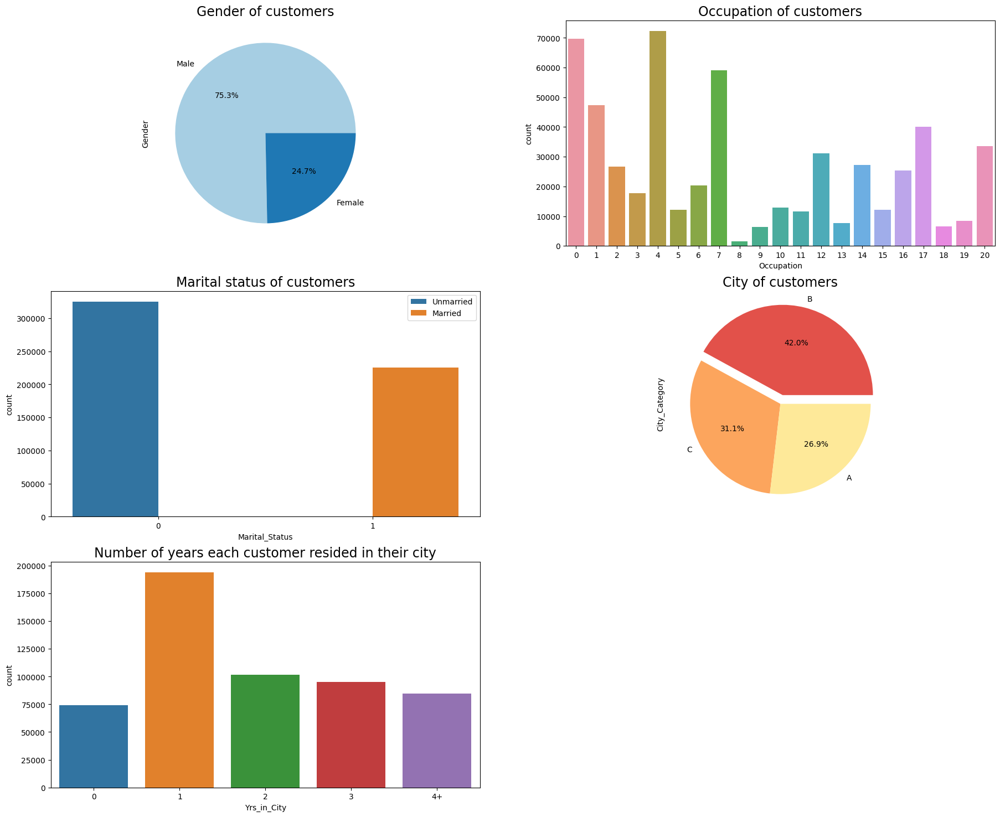

In [ ]:

fig=px.pie(df, names=['Adult','Teenage','Mid-Age','Old','Child'], values=df['Age'].value_counts(), color_discrete_sequence=px.colors.diverging.Spectral)
fig.update_layout(title_text='Age distribution of customers', title_x=0.5, title_font = dict(color='brown', size=20))
fig.show()

plt.figure(figsize=(22,18))
plt.subplot(3,2,1)
df['Gender'].value_counts().plot.pie(labels=['Male','Female'], autopct='%.1f%%', colors=sns.color_palette('Paired'))
plt.title('Gender of customers',fontsize=17)

plt.subplot(3,2,2)
sns.countplot(data=df, x='Occupation')
plt.title('Occupation of customers',fontsize=17)

plt.subplot(3,2,3)
sns.countplot(data=df, x='Marital_Status', hue='Marital_Status')
plt.legend(labels=['Unmarried', 'Married'])
plt.title('Marital status of customers',fontsize=17)

plt.subplot(3,2,4)
df['City_Category'].value_counts().plot.pie(explode=[0.1,0,0], autopct='%.1f%%', colors=sns.color_palette('Spectral'))
plt.title('City of customers',fontsize=17)

plt.subplot(3,2,5)
sns.countplot(data=df, x='Yrs_in_City', order=['0','1','2','3','4+'])
plt.title('Number of years each customer resided in their city',fontsize=17);

#### **List of observations from the subplots**



    1.   Majority of customers are from the adult age group and least from the child age group.
    2.   The number of males who visit the store is approximately thrice the number of females.
    3.   Customers with occupation 8 are the least and with occupation 0 and 4 have done comparatively more transactions on a Black Friday Sale.
    4.   The number of unmarried customers are relatively high compared to married ones.
    5.   City B has the highest number of customers amongst all the cities.
    6.   Most people prefer to live for a year in their respective cities but there are a good number of people who reside for more than a year.










## **Let's find out the purchase distribution of users**

In [ ]:
sns.set_style('darkgrid')

## Q: Show the purchase distribution of unmarried and married customers. Find out who purchased more than the other on a Black Friday Sale?

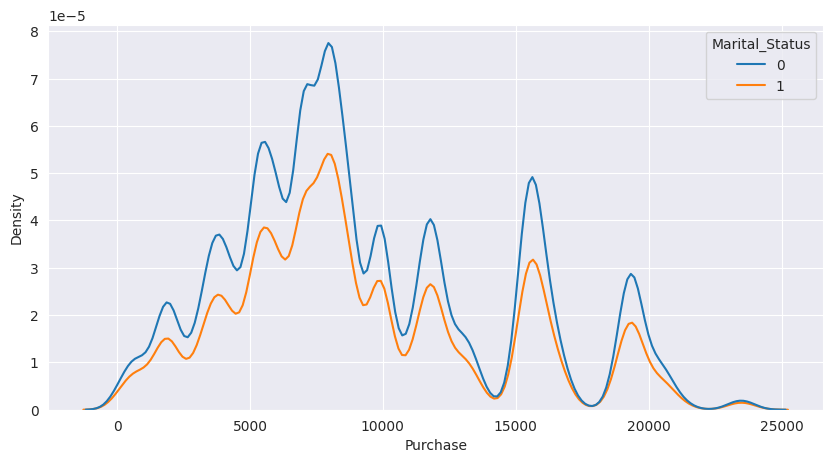

In [ ]:
plt.figure(figsize=(10,5),dpi=100)
sns.kdeplot(data=df, x='Purchase', hue='Marital_Status');

    From the above Kernel Distribution Estimation plot, it is observed that Unmarried customers tend to spend more compared to the
    married ones on a Black Friday Sale.

## Q: Find out which gender has spent the most while visiting the store on a Black Friday Sale? Also plot the purchase distribution of males and females.

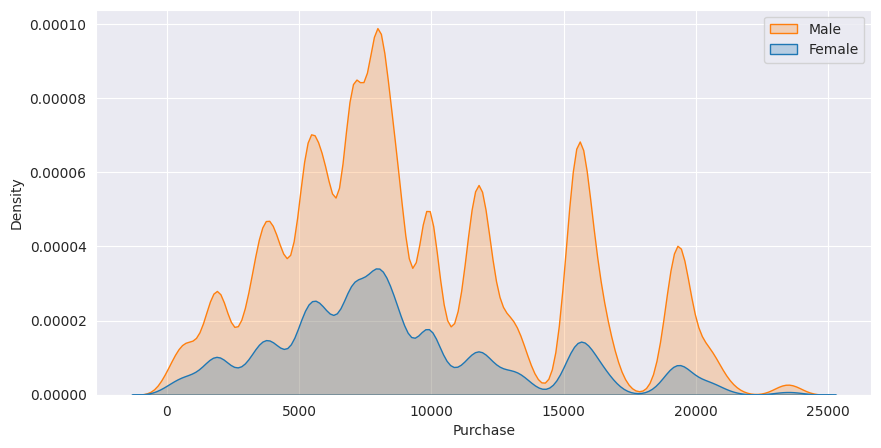

In [ ]:
plt.figure(figsize=(10,5),dpi=100)
sns.kdeplot(data=df, x='Purchase', hue='Gender', fill=True)
plt.legend(labels=['Male','Female']);

    This graph shows us the distribution pattern of both genders and we can conclude that males purchase higher than females during the sale.

##**To detect outliers in the dataset**

In [ ]:
# calculating outliers using statistical methods
# here we are using the Inter Quartile Range method

def find_outliers_IQR(data):
   q1=data.quantile(0.25)
   q3=data.quantile(0.75)
   IQR=q3-q1
   outliers = data[((data < (q1-1.5*IQR)) | (data > (q3+1.5*IQR)))]
   return outliers

In [ ]:
outliers = find_outliers_IQR(df['Purchase'])
print('Number of outliers: '+ str(len(outliers)))
print('Max outlier value: '+ str(outliers.max()))
print('Min outlier value: '+ str(outliers.min()),'\n')
outliers

Number of outliers: 2677
Max outlier value: 23961
Min outlier value: 21401 



343       23603
375       23792
652       23233
736       23595
1041      23341
          ...  
544488    23753
544704    23724
544743    23529
545663    23663
545787    23496
Name: Purchase, Length: 2677, dtype: int64

## **Distribution along with detection of outliers in the `Purchase` field**

In [ ]:
df['Purchase'].describe()

count    550068.000000
mean       9263.968713
std        5023.065394
min          12.000000
25%        5823.000000
50%        8047.000000
75%       12054.000000
max       23961.000000
Name: Purchase, dtype: float64

### Q: Find the density of purchase in which most of the purchase took place. Also check the distribution and outliers of the purchase column

In [ ]:
px.histogram(data_frame=df, x='Purchase', marginal='box')

    Visual representation of distribution of Purchase amongst all visitors of the store on a Black Friday Sale through a
    histogram and identification of outliers through an overlying boxplot.

# **Bivariate Analysis**

## Q: People belonging to what particular occupation often tend to purchase the most on a Black Friday Sale?

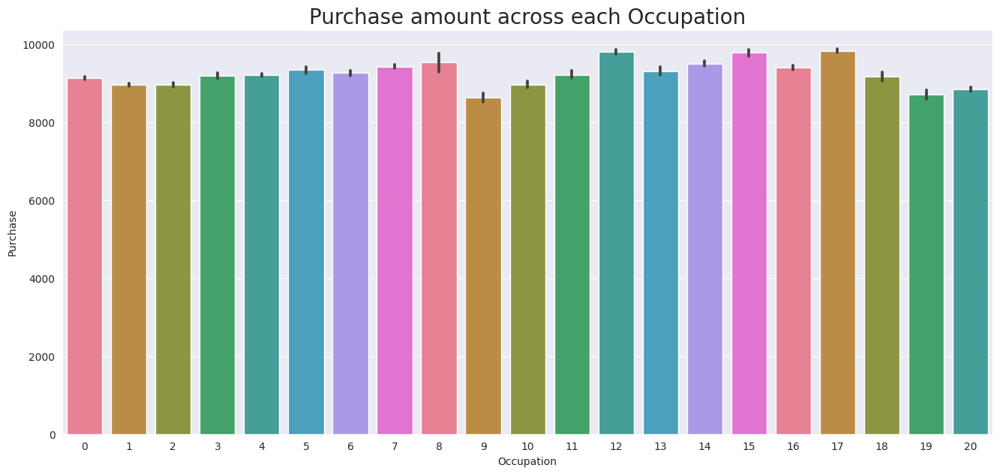

In [ ]:
plt.figure(figsize=(16,7))
sns.barplot(df,x='Occupation', y='Purchase', palette=sns.color_palette('husl', 8))
plt.title('Purchase amount across each Occupation', fontsize=20);

    People who belong to occupation 12, 15 and 17 are the ones who purchase a lot compared to other occupations on a Black Friday Sale.

In [ ]:
px.box(df, x='Age', y='Purchase')

    Boxplots are used to identify the outliers in the data and tells us how tightly the data is grouped and how our data is skewed.
    
    From the above boxplot, we can see that the median of purchases amongst different age groups are gradually but slightly increasing.
    It makes sense because as people get older, their expenses increase and tend to purchase more items at a superstore.

## Q: On an average what quantity of Product1 is purchased the most by the customers who visit the store?

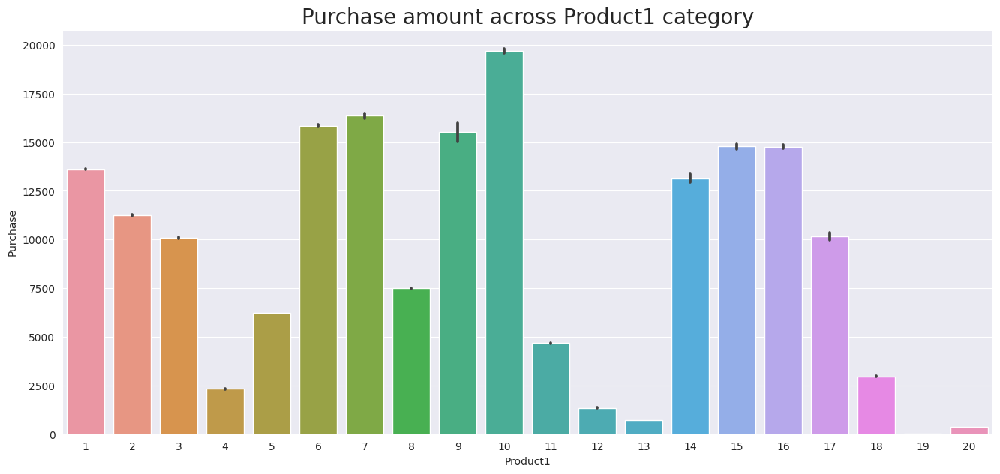

In [ ]:
plt.figure(figsize=(16,7))
sns.barplot(df, x='Product1', y='Purchase')
plt.title('Purchase amount across Product1 category', fontsize=20);

    This graph shows the average Purchase distribution for each quantity of Product1 purchased by different users/customers at the sale.
    
    Use the below codeline for reference and better understanding of the above graph.


In [ ]:
df.groupby('Product1')['Purchase'].agg('mean').sort_values(ascending=False)

Product1
10    19675.570927
7     16365.689600
6     15838.478550
9     15537.375610
15    14780.451828
16    14766.037037
1     13606.218596
14    13141.625739
2     11251.935384
17    10170.759516
3     10096.705734
8      7498.958078
5      6240.088178
11     4685.268456
18     2972.864320
4      2329.659491
12     1350.859894
13      722.400613
20      370.481176
19       37.041797
Name: Purchase, dtype: float64

# **Multivariate Analysis**

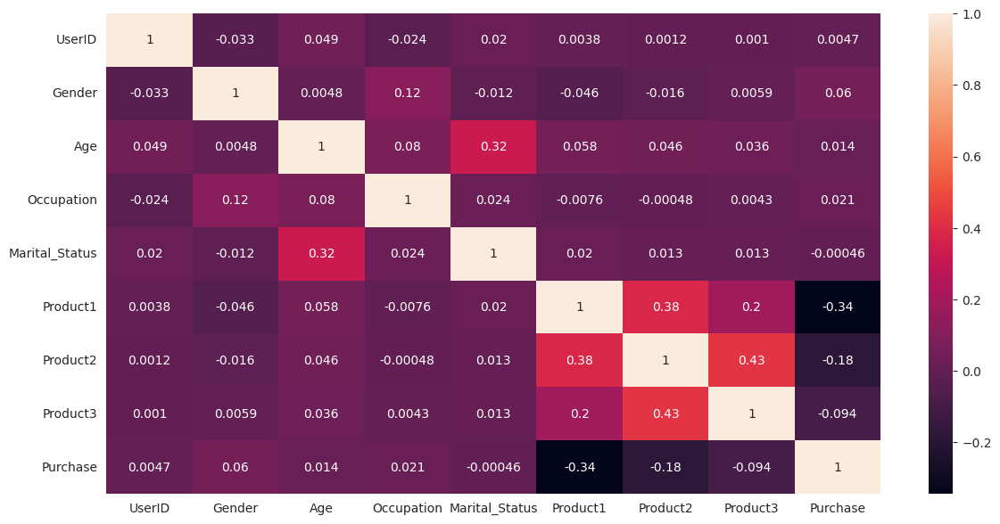

In [ ]:
plt.figure(figsize=(14,7))
sns.heatmap(df.corr(), annot=True);

    From the above heatmap, we can observe that there are strong correlations between different product types with the `Purchase` variable.

    A negative correlation is a relationship between two variables that move in opposite directions. In other words, it's a situation where one
    variable increases in value while the other decreases.
    Whereas, a positive correlation is a relationship between two variables that move in tandem, that is, along the same direction. In other words,
    when one variable decreases, the other variable decreases too and vice versa.

    There is also some correlation between age and marital status which is pretty much understandable.
    Unfortunately, there is no single feature that shows strong correlation with purchase directly, so we
    can understand this as that `Purchase` depends on the ensemble of all features.

# **Other Miscellaneous Analysis**

In [ ]:
px.histogram(df,x='Product1', color_discrete_sequence = px.colors.sequential.RdBu)

    Product 1 is purchased in pair of 5 very often.

In [ ]:
px.histogram(df,x='Product2', color_discrete_sequence = px.colors.diverging.Fall)

    Product 2 is purchased in pair of 10 the highest.

In [ ]:
px.histogram(df,x='Product3', color_discrete_sequence = px.colors.diverging.RdYlBu)

    Product 3 is purchased in pair of 14 frequently.

In [ ]:
px.box(df,y=['Product1', 'Product2', 'Product3'])

    From the above barplots of different product categories,

    1) We see that people purchase Product1 in all quantities and most prominently in quantities less than 10.
    2) Product2 is purchased in almost all quantities but more in the range of 7-15.
    3) Since, Product3 is purchased most often in quantity of 14, there's not much that can be analysed from it.




In [ ]:
df.to_csv('cleaned_train.csv')

In [ ]:
df1 = pd.read_csv('/content/cleaned_train.csv')
df1

,Unnamed: 0,UserID,ProductID,Gender,Age,Occupation,City_Category,Yrs_in_City,Marital_Status,Product1,Product2,Product3,Purchase
0,0,1000001,P00069042,0,0,10,A,2,0,3,10.0,14.0,8370
1,1,1000001,P00248942,0,0,10,A,2,0,1,6.0,14.0,15200
2,2,1000001,P00087842,0,0,10,A,2,0,12,10.0,14.0,1422
3,3,1000001,P00085442,0,0,10,A,2,0,12,14.0,14.0,1057
4,4,1000002,P00285442,1,4,16,C,4+,0,8,10.0,14.0,7969
...,...,...,...,...,...,...,...,...,...,...,...,...,...
550063,550063,1006033,P00372445,1,3,13,B,1,1,20,10.0,14.0,368
550064,550064,1006035,P00375436,0,2,1,C,3,0,20,10.0,14.0,371
550065,550065,1006036,P00375436,0,2,15,B,4+,1,20,10.0,14.0,137
550066,550066,1006038,P00375436,0,4,1,C,2,0,20,10.0,14.0,365
